In [499]:
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import warnings; warnings.filterwarnings(action='once')

In [501]:
pd.set_option('display.max_column', 100)
pd.set_option('display.width', 100)

# Unused
Because Own Goal data not used. Making the goal scored difference with standings data

In [ ]:
df_2022 = pd.read_html('https://fbref.com/en/comps/9/2022-2023/stats/2022-2023-Premier-League-Stats')
df_2023 = pd.read_html('https://fbref.com/en/comps/9/2023-2024/stats/2023-2024-Premier-League-Stats')
df_2024 = pd.read_html('https://fbref.com/en/comps/9/stats/Premier-League-Stats')

# xG and Goals Difference

### Function

In [502]:
def preprocess_xg(df):
    df = pd.DataFrame(df[0])
    df.columns = df.columns.droplevel()
    df = df.iloc[:,0:22]
    df['G-xG'] = df.Gls-df.xG
    df = df.sort_values('G-xG',ascending=True).reset_index(drop=True)
    return df


def line_chart(df):
    return df.plot.line(x='Squad',y=['xG','Gls'])

def bar_chart_h(df):
    return df.plot.barh(x='Squad',y=['Gls','xG'],color={"Gls":"Red","xG":"Blue"})

def visualization_xg(df, season, filename):
    df = df.sort_values('G-xG',ascending=True).reset_index(drop=True)
    viz_dat = df[['Squad','xG','Gls','G-xG']]
    # Draw plot
    import matplotlib.patches as patches

    fig, ax = plt.subplots(figsize=(25,15), facecolor='white', dpi= 300)

    x=viz_dat.index
    w = 0.3
    ax.vlines(x=x, ymin=0, ymax=viz_dat.Gls, color='seagreen', alpha=0.7, linewidth=20,label="Goals")
    ax.vlines(x=x-w, ymin=0, ymax=viz_dat.xG, color='darkblue', alpha=0.7, linewidth=20,label="xG")
    #ax.bar(x-w,viz_dat.xG,width=w,color='green',align='center')
    #ax.bar(x,viz_dat.Gls,width=w,color='firebrick',align='center')
    ax.legend(loc="upper left",fontsize="20")

    # Annotate Text
    for i, a in enumerate(viz_dat.Gls):
        if a>=viz_dat['xG'][i]:
            ax.text(i-0.2, a+3.5, round(viz_dat['G-xG'][i],1), horizontalalignment='center', fontdict={'size':14,'fontweight':'bold','color':'green'})
            ax.text(i-0.2, a+0.9, (viz_dat['xG'][i],viz_dat['Gls'][i]), horizontalalignment='center',fontdict={'size':11,'fontweight':'bold'})
        else:
            ax.text(i-0.2, viz_dat['xG'][i]+3.5, round(viz_dat['G-xG'][i],1), horizontalalignment='center',fontdict={'size':14,'fontweight':'bold','color':'red'})
            ax.text(i-0.2, viz_dat['xG'][i]+0.9, (viz_dat['xG'][i],viz_dat['Gls'][i]), horizontalalignment='center',fontdict={'size':11,'fontweight':'bold'})

    # Title, Label, Ticks and Ylim
    ax.set_title(f'xG and Goals Difference Premier League Season {season}', fontdict={'size':30})
    ax.set(ylim=(0,max(viz_dat['Gls'])+20))
    ax.set_ylabel('xG or Goals',fontsize=14,fontweight='bold')
    plt.xticks(viz_dat.index, viz_dat.Squad, rotation=40, horizontalalignment='right', fontsize=12,fontweight='bold')
    ax.text(-.03, -.17, 'Data: FBRef (https://fbref.com/en/)', ha='left', va='bottom', transform=ax.transAxes,fontdict={'size':14,'fontweight':'bold','color':'black'})
    ax.text(.99, -.17, 'Twitter:@patrickcw_', ha='right', va='bottom', transform=ax.transAxes,fontdict={'size':14,'fontweight':'bold','color':'black'})
    # Add patches to color the X axis labels
    #p1 = patches.Rectangle((green_start, 0.01), width=green_width, height=.10, alpha=.15, facecolor='green', transform=fig.transFigure)
    #p2 = patches.Rectangle((.124, 0.01), width=red_width, height=.10, alpha=.15, facecolor='red', transform=fig.transFigure)

    for i in range(len(df)):
        color = '#fceeee' if df["G-xG"][i] < 0 else '#e9f7ee'
        ax.axvspan(i - 0.5, i + 0.5, color=color, zorder=0)

    #fig.add_artist(p1)
    #fig.add_artist(p2)
    #plt.grid()
    plt.grid(axis='x', linestyle='--', alpha=0.5)
    plt.grid(axis='y', linestyle='--', alpha=0.5)
    plt.savefig(filename,bbox_inches='tight')
    plt.show()

In [558]:
df_all_22

,Rk,Squad,MP,W,D,L,GF,GA,GD,Pts,Pts/MP,xG,xGA,xGD,xGD/90,Attendance,Top Team Scorer,Goalkeeper,Notes,G-xG,xGA-GA,GD-xGD
0,20,Southampton,38,6,7,25,36,73,-37,25,0.66,37.8,60.8,-23.0,-0.61,30440,James Ward-Prowse - 9,Gavin Bazunu,Relegated,-1.8,-12.2,-14.0
1,19,Leeds United,38,7,10,21,48,78,-30,31,0.82,47.3,67.1,-19.8,-0.52,36566,Rodrigo - 13,Illan Meslier,Relegated,0.7,-10.9,-10.2
2,18,Leicester City,38,9,7,22,51,68,-17,34,0.89,50.5,63.3,-12.8,-0.34,31887,Harvey Barnes - 13,Danny Ward,Relegated,0.5,-4.7,-4.2
3,17,Everton,38,8,12,18,34,57,-23,36,0.95,45.2,65.5,-20.4,-0.54,39243,Dwight McNeil - 7,Jordan Pickford,NaN,-11.2,8.5,-2.6
4,16,Nott'ham Forest,38,9,11,18,38,68,-30,38,1.00,39.3,64.2,-24.9,-0.66,29188,Taiwo Awoniyi - 10,Dean Henderson,NaN,-1.3,-3.8,-5.1
5,15,Bournemouth,38,11,6,21,37,71,-34,39,1.03,38.5,63.8,-25.3,-0.67,10362,Philip Billing - 7,Neto,NaN,-1.5,-7.2,-8.7
6,14,West Ham,38,11,7,20,42,55,-13,40,1.05,49.2,53.0,-3.9,-0.10,62462,"Saïd Benrahma, Jarrod Bowen - 6",Łukasz Fabiański,NaN,-7.2,-2.0,-9.1
7,13,Wolves,38,11,8,19,31,58,-27,41,1.08,36.8,59.9,-23.0,-0.61,31482,"Rúben Neves, Daniel Podence - 6",José Sá,NaN,-5.8,1.9,-4.0
8,12,Chelsea,38,11,11,16,38,47,-9,44,1.16,49.5,52.5,-3.0,-0.08,40002,Kai Havertz - 7,Kepa Arrizabalaga,NaN,-11.5,5.5,-6.0
9,11,Crystal Palace,38,11,12,15,40,49,-9,45,1.18,39.3,48.1,-8.8,-0.23,24952,Eberechi Eze - 10,Vicente Guaita,NaN,0.7,-0.9,-0.2


In [557]:
df_2022
df = pd.DataFrame(df_2022[0])
df.columns = df.columns.droplevel()
df = df.iloc[:,0:22]
df['G-xG'] = df.Gls-df.xG
df

,Squad,# Pl,Age,Poss,MP,Starts,Min,90s,Gls,Ast,G+A,G-PK,PK,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,G-xG
0,Arsenal,26,24.7,59.3,38,418,3420,38.0,84,64,148,81,3,4,51,0,71.6,68.9,53.5,122.4,824,2049,12.4
1,Aston Villa,26,27.0,49.3,38,418,3420,38.0,49,35,84,46,3,4,80,1,50.3,47.2,38.8,86.0,637,1242,-1.3
2,Bournemouth,31,26.3,40.4,38,418,3420,38.0,37,24,61,37,0,0,68,0,38.5,38.5,28.4,66.9,504,1006,-1.5
3,Brentford,25,26.2,43.8,38,418,3420,38.0,56,36,92,49,7,8,57,1,56.3,50.1,38.4,88.5,392,1131,-0.3
4,Brighton,29,26.3,60.2,38,418,3420,38.0,68,46,114,62,6,6,58,0,73.3,68.9,52.2,121.2,809,1849,-5.3
5,Chelsea,32,26.3,58.7,38,418,3420,38.0,37,27,64,34,3,3,81,3,49.5,47.2,38.6,85.8,829,1737,-12.5
6,Crystal Palace,26,26.7,46.3,38,418,3420,38.0,38,29,67,37,1,3,82,3,39.3,36.8,29.0,65.8,556,1243,-1.3
7,Everton,28,26.6,42.8,38,418,3420,38.0,32,24,56,29,3,3,81,2,45.2,42.8,32.4,75.1,500,1052,-13.2
8,Fulham,29,28.2,48.8,38,418,3420,38.0,52,33,85,47,5,9,80,1,46.2,39.1,28.5,67.7,663,1326,5.8
9,Leeds United,29,25.3,47.0,38,418,3420,38.0,45,31,76,44,1,3,89,3,47.3,44.9,31.8,76.7,555,1429,-2.3


In [552]:
df_dat_22

,Squad,# Pl,Age,Poss,MP,Starts,Min,90s,Gls,Ast,G+A,G-PK,PK,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,G-xG
0,Everton,28,26.6,42.8,38,418,3420,38.0,32,24,56,29,3,3,81,2,45.2,42.8,32.4,75.1,500,1052,-13.2
1,Chelsea,32,26.3,58.7,38,418,3420,38.0,37,27,64,34,3,3,81,3,49.5,47.2,38.6,85.8,829,1737,-12.5
2,Manchester Utd,26,26.9,53.7,38,418,3420,38.0,56,42,98,53,3,3,78,2,67.7,65.3,52.2,117.5,711,1595,-11.7
3,Wolves,32,26.7,49.9,38,418,3420,38.0,28,12,40,25,3,3,85,6,36.8,34.5,25.4,60.0,610,1343,-8.8
4,West Ham,25,28.2,42.1,38,418,3420,38.0,41,25,66,35,6,8,44,0,49.2,43.7,32.7,76.4,615,1274,-8.2
5,Newcastle Utd,27,27.3,52.3,38,418,3420,38.0,64,42,106,58,6,6,61,1,71.9,67.3,51.8,119.1,695,1618,-7.9
6,Brighton,29,26.3,60.2,38,418,3420,38.0,68,46,114,62,6,6,58,0,73.3,68.9,52.2,121.2,809,1849,-5.3
7,Nott'ham Forest,33,26.5,37.6,38,418,3420,38.0,36,22,58,33,3,6,84,0,39.3,34.6,26.3,61.0,436,859,-3.3
8,Leeds United,29,25.3,47.0,38,418,3420,38.0,45,31,76,44,1,3,89,3,47.3,44.9,31.8,76.7,555,1429,-2.3
9,Southampton,36,24.7,44.5,38,418,3420,38.0,36,25,61,34,2,4,73,0,37.8,34.6,28.1,62.7,588,1125,-1.8


### Prem 2022

In [550]:
df_dat_22 = preprocess_xg(df_2022)
df_dat_22

,Squad,# Pl,Age,Poss,MP,Starts,Min,90s,Gls,Ast,G+A,G-PK,PK,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,G-xG
0,Everton,28,26.6,42.8,38,418,3420,38.0,32,24,56,29,3,3,81,2,45.2,42.8,32.4,75.1,500,1052,-13.2
1,Chelsea,32,26.3,58.7,38,418,3420,38.0,37,27,64,34,3,3,81,3,49.5,47.2,38.6,85.8,829,1737,-12.5
2,Manchester Utd,26,26.9,53.7,38,418,3420,38.0,56,42,98,53,3,3,78,2,67.7,65.3,52.2,117.5,711,1595,-11.7
3,Wolves,32,26.7,49.9,38,418,3420,38.0,28,12,40,25,3,3,85,6,36.8,34.5,25.4,60.0,610,1343,-8.8
4,West Ham,25,28.2,42.1,38,418,3420,38.0,41,25,66,35,6,8,44,0,49.2,43.7,32.7,76.4,615,1274,-8.2
5,Newcastle Utd,27,27.3,52.3,38,418,3420,38.0,64,42,106,58,6,6,61,1,71.9,67.3,51.8,119.1,695,1618,-7.9
6,Brighton,29,26.3,60.2,38,418,3420,38.0,68,46,114,62,6,6,58,0,73.3,68.9,52.2,121.2,809,1849,-5.3
7,Nott'ham Forest,33,26.5,37.6,38,418,3420,38.0,36,22,58,33,3,6,84,0,39.3,34.6,26.3,61.0,436,859,-3.3
8,Leeds United,29,25.3,47.0,38,418,3420,38.0,45,31,76,44,1,3,89,3,47.3,44.9,31.8,76.7,555,1429,-2.3
9,Southampton,36,24.7,44.5,38,418,3420,38.0,36,25,61,34,2,4,73,0,37.8,34.6,28.1,62.7,588,1125,-1.8


<Axes: xlabel='Squad'>

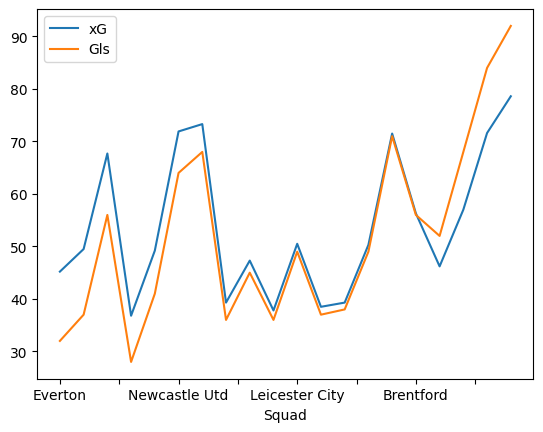

In [504]:
line_chart(df_dat_22)

<Axes: ylabel='Squad'>

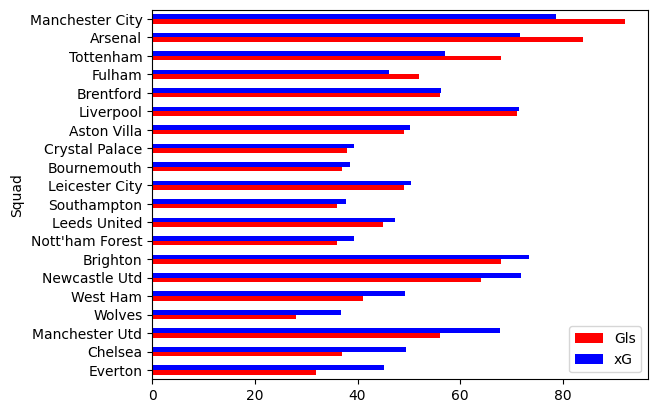

In [505]:
bar_chart_h(df_dat_22)

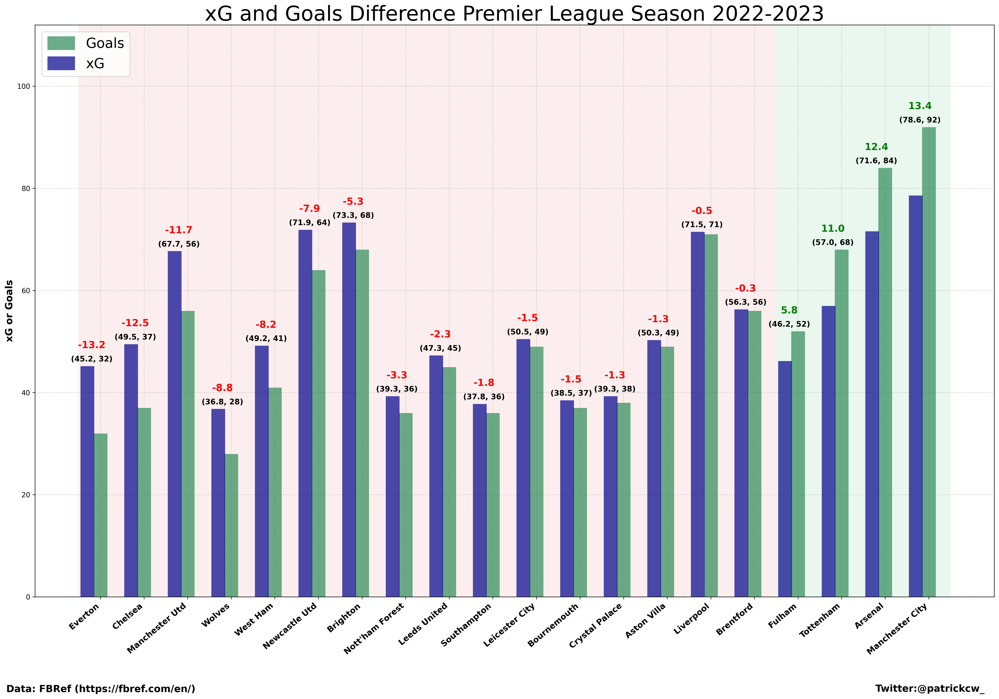

In [506]:
season = "2022-2023"
filename = "xG_G_Diff_2022_2023.png"
visualization_xg(df_dat_22,season,filename)

### Prem 2023

In [507]:
df_dat_23 = preprocess_xg(df_2023)
df_dat_23

,Squad,# Pl,Age,Poss,MP,Starts,Min,90s,Gls,Ast,G+A,G-PK,PK,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,G-xG
0,Everton,26,27.1,40.8,38,418,3420,38.0,40,17,57,38,2,3,82,1,54.0,51.6,38.1,89.8,495,1129,-14.0
1,Liverpool,30,26.3,61.3,38,418,3420,38.0,80,60,140,74,6,9,69,5,87.8,80.4,63.7,144.1,924,2110,-7.8
2,Sheffield Utd,35,25.7,35.8,38,418,3420,38.0,31,18,49,26,5,5,101,5,38.3,34.5,25.8,60.3,346,884,-7.3
3,Brighton,30,25.9,59.8,38,418,3420,38.0,50,36,86,45,5,6,90,3,56.8,52.2,41.6,93.8,864,1780,-6.8
4,Brentford,28,26.6,45.2,38,418,3420,38.0,54,38,92,51,3,3,89,2,58.2,56.0,42.7,98.8,505,1283,-4.2
5,Bournemouth,30,25.7,44.4,38,418,3420,38.0,52,39,91,50,2,3,79,3,55.9,53.6,40.5,94.0,709,1314,-3.9
6,Nott'ham Forest,33,25.7,40.6,38,418,3420,38.0,49,43,92,48,1,1,82,3,49.9,49.1,37.9,87.0,601,1141,-0.9
7,Burnley,31,24.5,47.4,38,418,3420,38.0,40,30,70,37,3,3,77,7,40.6,38.3,29.7,68.0,727,1181,-0.6
8,Wolves,27,26.6,48.9,38,418,3420,38.0,47,36,83,43,4,4,102,4,46.7,43.6,31.8,75.4,671,1180,0.3
9,Manchester Utd,31,26.1,50.6,38,418,3420,38.0,57,36,93,51,6,7,83,1,56.5,51.0,40.1,91.0,758,1479,0.5


<Axes: xlabel='Squad'>

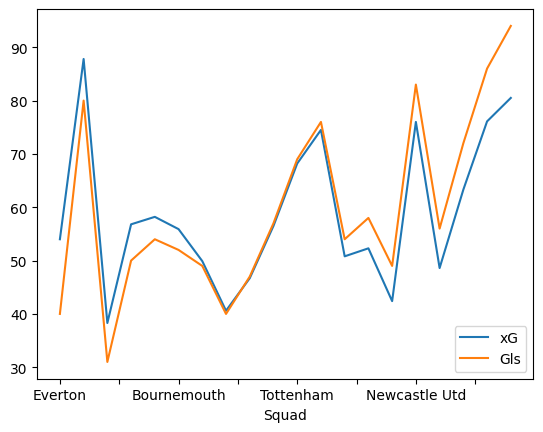

In [508]:
line_chart(df_dat_23)

<Axes: ylabel='Squad'>

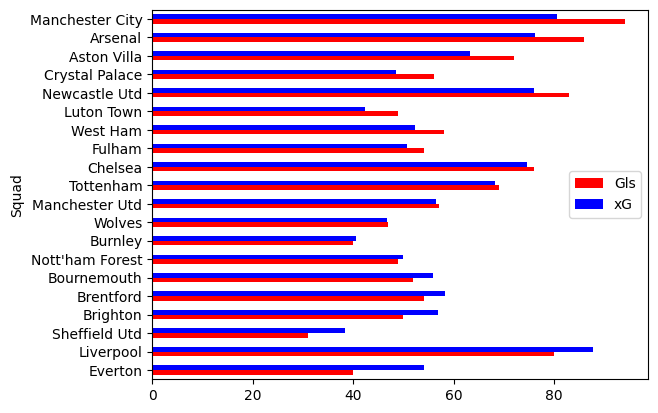

In [509]:
bar_chart_h(df_dat_23)

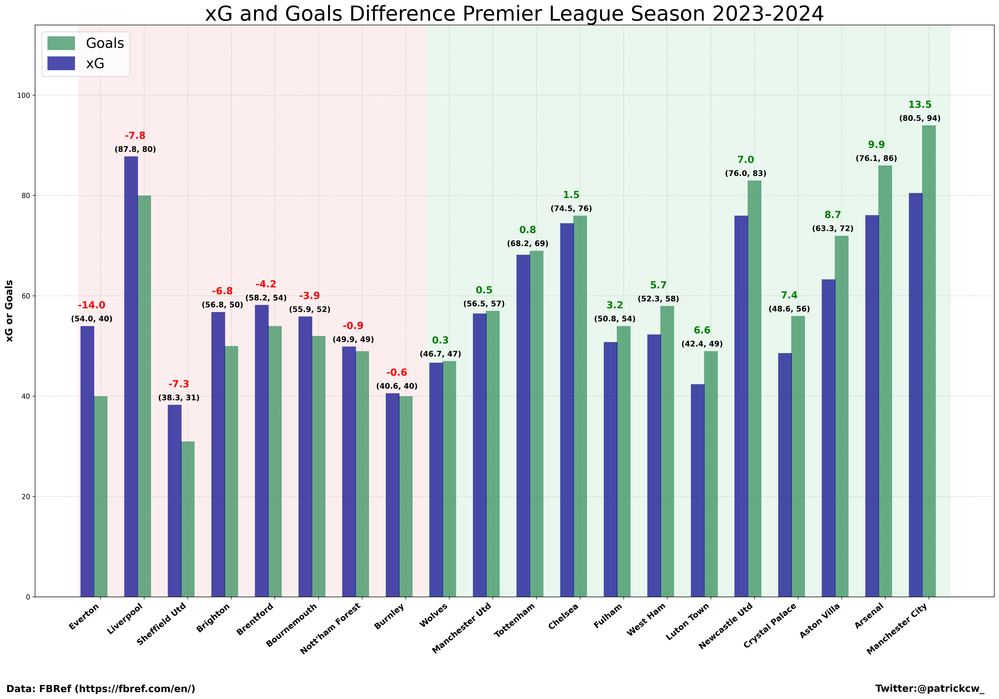

In [510]:
season = "2023-2024"
filename = "xG_G_Diff_2023_2024.png"
visualization_xg(df_dat_23, season, filename)

### Prem 2024

In [511]:
df_dat_24 = preprocess_xg(df_2024)
df_dat_24

,Squad,# Pl,Age,Poss,MP,Starts,Min,90s,Gls,Ast,G+A,G-PK,PK,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,G-xG
0,Crystal Palace,29,27.0,43.2,35,385,3150,35.0,42,32,74,39,3,4,78,4,53.6,50.5,39.9,90.4,463,1067,-11.6
1,Manchester Utd,31,26.2,53.2,35,385,3150,35.0,40,28,68,37,3,3,78,3,47.2,44.9,35.8,80.6,632,1297,-7.2
2,Southampton,35,26.1,49.4,35,385,3150,35.0,24,15,39,24,0,2,86,3,30.7,29.0,23.6,52.6,611,1067,-6.7
3,Bournemouth,29,25.9,47.7,35,385,3150,35.0,54,39,93,48,6,7,90,2,60.5,55.0,41.6,96.6,692,1356,-6.5
4,Chelsea,29,24.5,57.7,35,385,3150,35.0,59,45,104,55,4,5,96,1,65.2,61.3,50.4,111.7,811,1497,-6.2
5,West Ham,27,28.9,47.9,35,385,3150,35.0,37,24,61,34,3,3,74,3,43.1,40.8,31.2,72.0,573,1125,-6.1
6,Everton,26,28.7,40.9,35,385,3150,35.0,33,22,55,31,2,2,77,2,36.9,35.3,28.0,63.3,448,959,-3.9
7,Leicester City,31,27.4,45.5,35,385,3150,35.0,29,22,51,27,2,3,81,0,30.5,28.3,23.7,52.0,550,1013,-1.5
8,Aston Villa,28,27.8,51.0,35,385,3150,35.0,53,42,95,50,3,6,68,2,53.3,48.5,39.6,88.1,666,1237,-0.3
9,Brighton,31,25.7,52.3,35,385,3150,35.0,55,37,92,50,5,5,75,3,52.7,48.9,37.0,85.9,740,1404,2.3


<Axes: xlabel='Squad'>

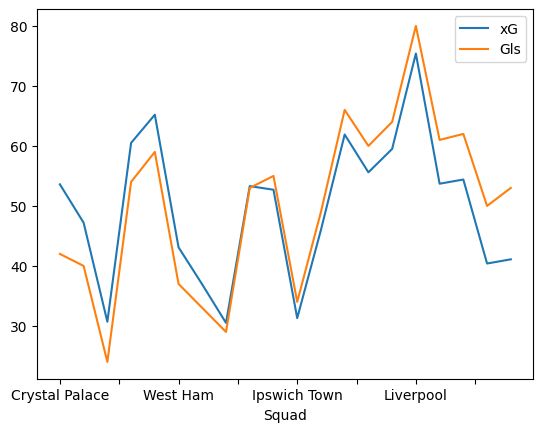

In [512]:
line_chart(df_dat_24)

<Axes: ylabel='Squad'>

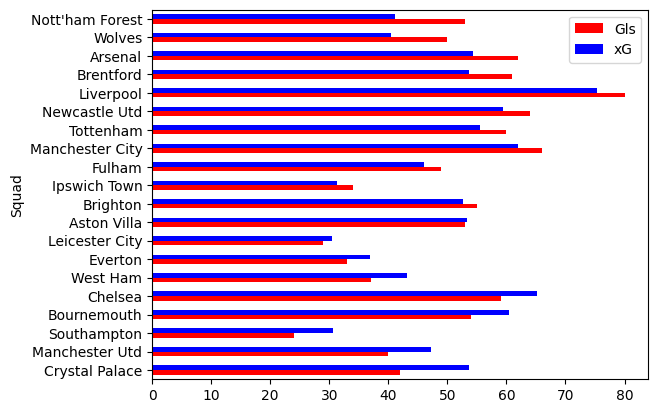

In [513]:
bar_chart_h(df_dat_24)

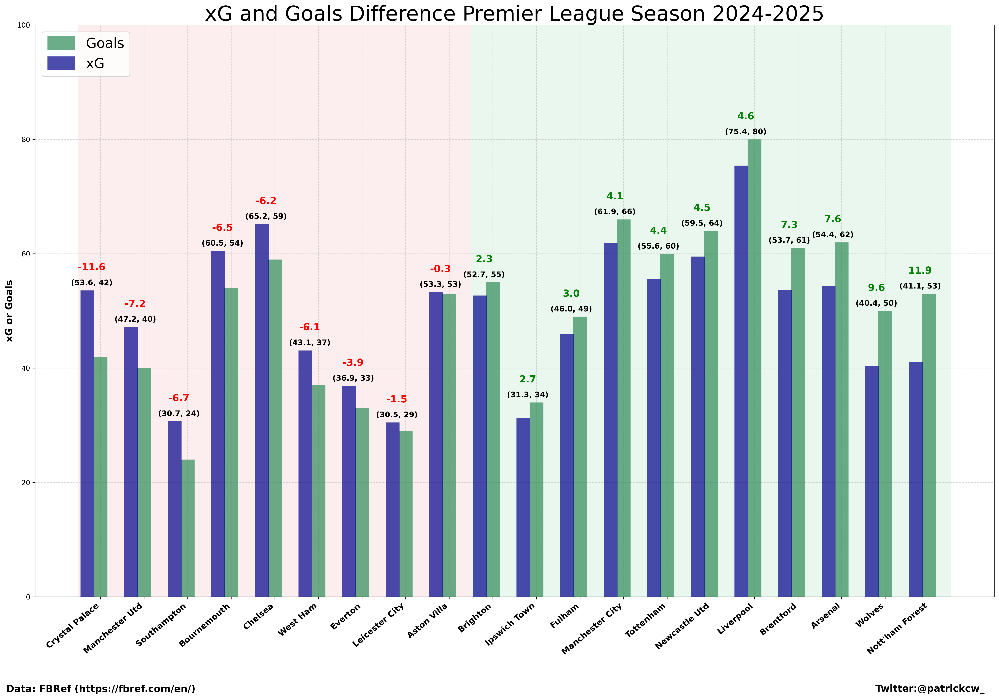

In [514]:
season = "2024-2025"
filename = "xG_G_Diff_2024_2025.png"
visualization_xg(df_dat_24, season, filename)

# xG Allowed and Goal Conceded

### Function

In [515]:
def preprocess_xga(df):
    df = pd.DataFrame(df[1])
    df.columns = df.columns.droplevel()
    df = df.iloc[:,0:22]
    df['xG-G'] = df.xG-df.Gls
    df['Squad'] = df['Squad'].str.replace('vs ', '', regex=False)
    df = df.sort_values('xG-G',ascending=True).reset_index(drop=True)
    return df


def line_chart(df):
    return df.plot.line(x='Squad',y=['xG','Gls'])

def bar_chart_h(df):
    return df.plot.barh(x='Squad',y=['Gls','xG'],color={"Gls":"Red","xG":"Blue"})

def visualization_xga(df, season, filename):
    df = df.sort_values('xG-G',ascending=True).reset_index(drop=True)
    viz_dat = df[['Squad','xG','Gls','xG-G']]
    # Draw plot
    import matplotlib.patches as patches

    fig, ax = plt.subplots(figsize=(25,15), facecolor='white', dpi= 300)

    x=viz_dat.index
    w = 0.3
    ax.vlines(x=x, ymin=0, ymax=viz_dat.Gls, color='crimson', alpha=0.7, linewidth=20,label="Goals Conceded")
    ax.vlines(x=x-w, ymin=0, ymax=viz_dat.xG, color='darkblue', alpha=0.7, linewidth=20,label="xG Allowed")
    #ax.bar(x-w,viz_dat.xG,width=w,color='green',align='center')
    #ax.bar(x,viz_dat.Gls,width=w,color='firebrick',align='center')
    ax.legend(loc="upper right",fontsize="20")

    # Annotate Text
    for i, a in enumerate(viz_dat.xG):
        if a>=viz_dat['Gls'][i]:
            ax.text(i-0.2, a+3.5, round(viz_dat['xG-G'][i],1), horizontalalignment='center', fontdict={'size':14,'fontweight':'bold','color':'green'})
            ax.text(i-0.2, a+0.9, (viz_dat['xG'][i],viz_dat['Gls'][i]), horizontalalignment='center',fontdict={'size':11,'fontweight':'bold'})
        else:
            ax.text(i-0.2, viz_dat['Gls'][i]+3.5, round(viz_dat['xG-G'][i],1), horizontalalignment='center',fontdict={'size':14,'fontweight':'bold','color':'red'})
            ax.text(i-0.2, viz_dat['Gls'][i]+0.9, (viz_dat['xG'][i],viz_dat['Gls'][i]), horizontalalignment='center',fontdict={'size':11,'fontweight':'bold'})

    # Title, Label, Ticks and Ylim
    ax.set_title(f'xG Allowed and Goals Conceded Difference Premier League Season {season}', fontdict={'size':30})
    ax.set(ylim=(0,max(viz_dat['Gls'])+20))
    ax.set_ylabel('xGA x Goals Conceded',fontsize=14,fontweight='bold')
    plt.xticks(viz_dat.index, viz_dat.Squad, rotation=40, horizontalalignment='right', fontsize=12,fontweight='bold')
    ax.text(-.03, -.17, 'Data: FBRef (https://fbref.com/en/)', ha='left', va='bottom', transform=ax.transAxes,fontdict={'size':14,'fontweight':'bold','color':'black'})
    ax.text(.99, -.17, 'Twitter:@patrickcw_', ha='right', va='bottom', transform=ax.transAxes,fontdict={'size':14,'fontweight':'bold','color':'black'})
    # Add patches to color the X axis labels
    #p1 = patches.Rectangle((green_start, 0.01), width=green_width, height=.10, alpha=.15, facecolor='green', transform=fig.transFigure)
    #p2 = patches.Rectangle((.124, 0.01), width=red_width, height=.10, alpha=.15, facecolor='red', transform=fig.transFigure)
    #fig.add_artist(p1)
    #fig.add_artist(p2)
    for i in range(len(df)):
        color = '#fceeee' if df["xG-G"][i] < 0 else '#e9f7ee'
        ax.axvspan(i - 0.5, i + 0.5, color=color, zorder=0)
    #plt.grid()
        
    plt.grid(axis='x', linestyle='--', alpha=0.5)
    plt.grid(axis='y', linestyle='--', alpha=0.5)
    plt.savefig(filename,bbox_inches='tight')
    plt.show()

### Prem 2022

In [516]:
df_dat_22 = preprocess_xga(df_2022)
df_dat_22

,Squad,# Pl,Age,Poss,MP,Starts,Min,90s,Gls,Ast,G+A,G-PK,PK,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,xG-G
0,Tottenham,29,26.7,50.1,38,418,3420,38.0,62,45,107,59,3,4,79,2,49.6,46.5,36.3,82.8,685,1516,-12.4
1,Leeds United,29,26.7,53.1,38,418,3420,38.0,77,50,127,72,5,6,66,3,67.1,62.4,49.8,112.2,596,1469,-9.9
2,Southampton,36,26.7,55.6,38,418,3420,38.0,68,55,123,66,2,3,63,2,60.8,58.4,46.2,104.6,653,1735,-7.2
3,Bournemouth,31,26.6,59.9,38,418,3420,38.0,68,49,117,62,6,7,51,0,63.8,58.3,45.3,103.6,810,1988,-4.2
4,Nott'ham Forest,33,26.8,62.8,38,418,3420,38.0,68,45,113,62,6,9,65,0,64.2,57.5,45.0,102.5,813,1904,-3.8
5,West Ham,25,26.6,58.2,38,418,3420,38.0,54,42,96,50,4,6,54,0,53.0,48.4,39.8,88.2,805,1721,-1.0
6,Arsenal,26,26.7,40.1,38,418,3420,38.0,42,27,69,39,3,5,84,1,42.0,38.0,31.6,69.6,510,907,0.0
7,Manchester City,24,26.6,34.7,38,418,3420,38.0,32,21,53,29,3,3,80,2,32.1,29.8,23.8,53.5,434,860,0.1
8,Leicester City,28,26.6,52.4,38,418,3420,38.0,63,46,109,59,4,5,64,2,63.3,59.8,47.9,107.7,721,1575,0.3
9,Crystal Palace,26,26.6,53.9,38,418,3420,38.0,46,32,78,42,4,4,83,3,48.1,44.9,34.5,79.4,590,1592,2.1


<Axes: xlabel='Squad'>

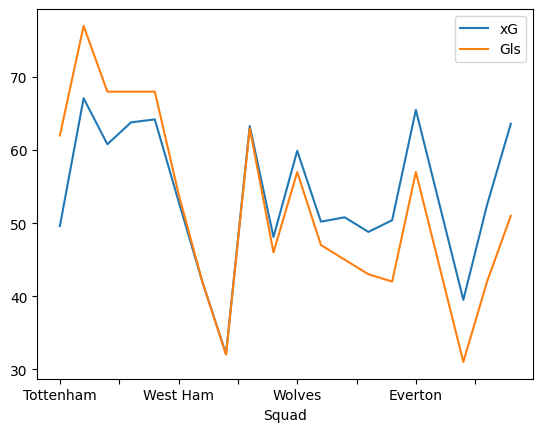

In [517]:
line_chart(df_dat_22)

<Axes: ylabel='Squad'>

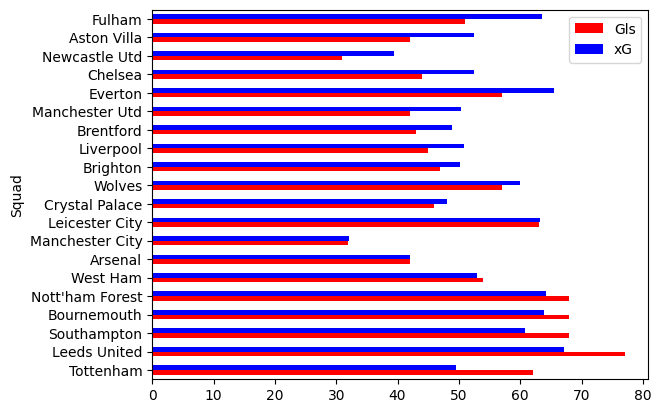

In [518]:
bar_chart_h(df_dat_22)

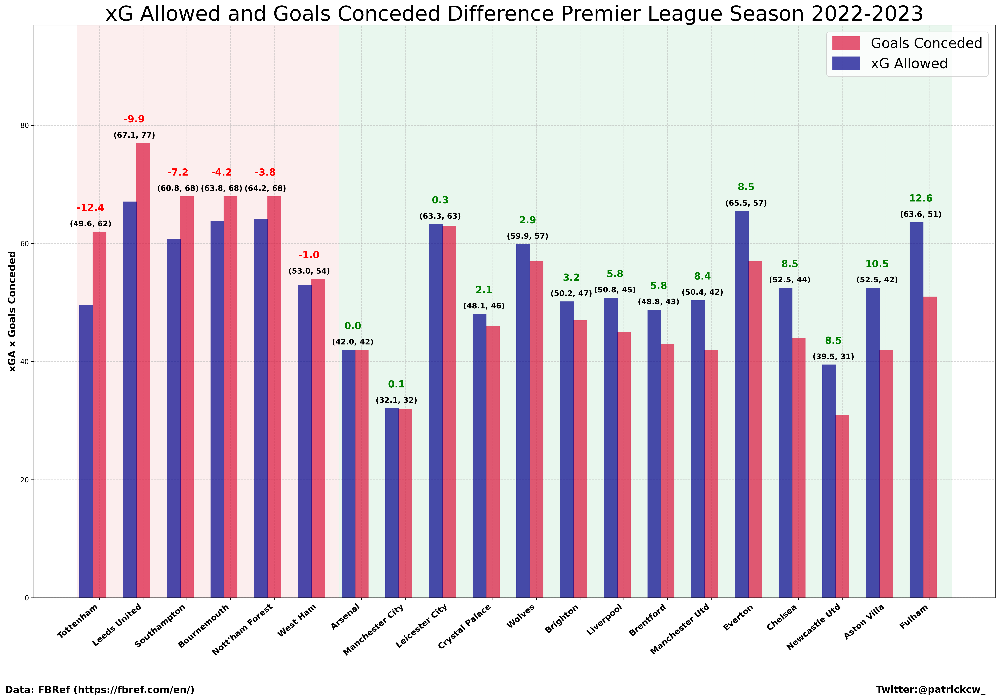

In [519]:
season = "2022-2023"
filename = "xGA_GA_Diff_2022_2023.png"
visualization_xga(df_dat_22, season, filename)

### Prem 2023

In [520]:
df_dat_23 = preprocess_xga(df_2023)
df_dat_23

,Squad,# Pl,Age,Poss,MP,Starts,Min,90s,Gls,Ast,G+A,G-PK,PK,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,xG-G
0,Sheffield Utd,35,26.4,64.2,38,418,3420,38.0,97,75,172,92,5,7,53,2,76.6,71.2,57.0,128.2,964,1975,-20.4
1,Nott'ham Forest,33,26.4,59.4,38,418,3420,38.0,65,48,113,61,4,4,81,7,53.3,50.1,37.1,87.2,815,1901,-11.7
2,Brentford,28,26.1,54.8,38,418,3420,38.0,65,50,115,63,2,2,75,4,56.0,54.4,43.6,98.0,847,1585,-9.0
3,Bournemouth,30,26.2,55.6,38,418,3420,38.0,66,44,110,60,6,7,82,2,58.1,52.5,39.9,92.4,720,1500,-7.9
4,Brighton,30,26.3,40.2,38,418,3420,38.0,60,42,102,54,6,6,99,5,55.4,50.7,39.3,90.0,651,1175,-4.6
5,Burnley,31,26.3,52.6,38,418,3420,38.0,75,54,129,69,6,7,84,3,70.4,64.9,52.0,116.9,711,1501,-4.6
6,Crystal Palace,26,26.3,57.7,38,418,3420,38.0,56,46,102,53,3,3,78,2,52.0,49.6,40.3,89.9,679,1713,-4.0
7,Luton Town,28,26.5,57.6,38,418,3420,38.0,81,57,138,77,4,4,73,2,78.0,74.9,56.8,131.7,723,1495,-3.0
8,Chelsea,32,26.3,41.4,38,418,3420,38.0,60,43,103,57,3,5,100,4,58.1,54.1,42.0,96.1,727,1368,-1.9
9,Arsenal,25,26.3,41.8,38,418,3420,38.0,28,20,48,26,2,3,82,2,27.9,25.7,19.9,45.6,534,938,-0.1


<Axes: xlabel='Squad'>

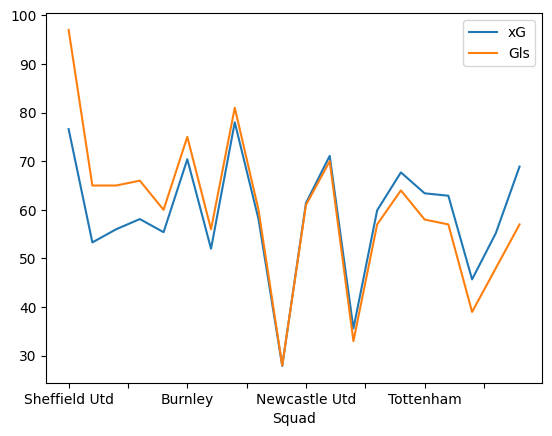

In [521]:
line_chart(df_dat_23)

<Axes: ylabel='Squad'>

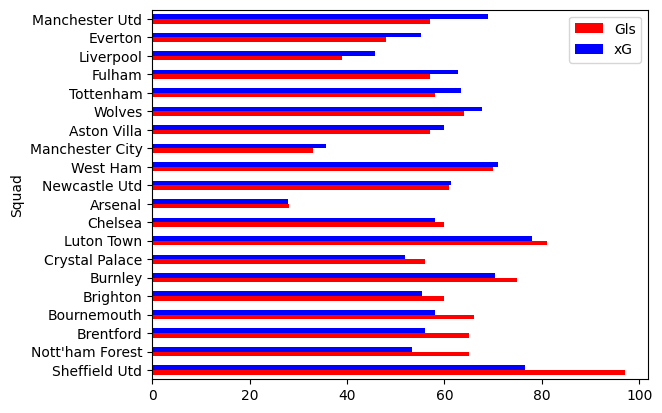

In [522]:
bar_chart_h(df_dat_23)

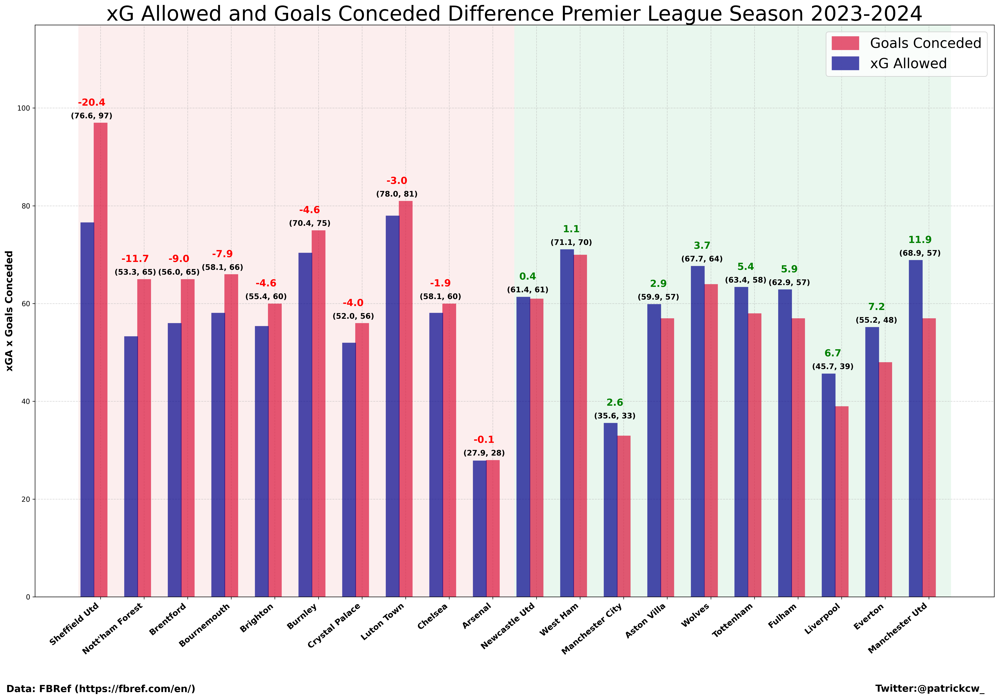

In [523]:
season = "2023-2024"
filename = "xGA_GA_Diff_2023_2024.png"
visualization_xga(df_dat_23, season, filename)

### Prem 2024

In [524]:
df_dat_24 = preprocess_xga(df_2024)
df_dat_24

,Squad,# Pl,Age,Poss,MP,Starts,Min,90s,Gls,Ast,G+A,G-PK,PK,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,xG-G
0,Wolves,30,27.1,52.7,35,385,3150,35.0,59,42,101,53,6,8,81,3,53.5,47.2,37.9,85.1,705,1441,-5.5
1,Leicester City,31,27.1,54.5,35,385,3150,35.0,73,53,126,70,3,4,55,2,67.6,64.5,49.0,113.6,675,1624,-5.4
2,Brighton,31,27.0,47.7,35,385,3150,35.0,54,37,91,46,8,8,89,5,49.4,43.3,37.2,80.5,548,1117,-4.6
3,Ipswich Town,32,27.0,60.0,35,385,3150,35.0,74,49,123,68,6,6,59,2,69.4,65.1,51.0,116.1,772,1622,-4.6
4,Fulham,26,27.0,47.8,35,385,3150,35.0,45,36,81,43,2,2,63,3,40.6,39.0,30.9,69.9,587,1272,-4.4
5,Southampton,35,27.0,50.6,35,385,3150,35.0,82,58,140,75,7,9,53,1,78.1,71.2,57.2,128.3,736,1458,-3.9
6,Aston Villa,28,27.2,49.0,35,385,3150,35.0,49,35,84,48,1,2,96,2,45.9,44.3,33.9,78.2,619,1174,-3.1
7,West Ham,27,27.0,52.1,35,385,3150,35.0,56,43,99,53,3,3,52,1,54.9,52.6,44.4,97.0,773,1498,-1.1
8,Arsenal,25,26.9,43.0,35,385,3150,35.0,31,21,52,28,3,3,79,2,29.9,27.5,20.9,48.5,558,852,-1.1
9,Liverpool,24,26.9,42.0,35,385,3150,35.0,33,24,57,32,1,2,80,1,32.0,30.3,24.5,54.9,606,983,-1.0


<Axes: xlabel='Squad'>

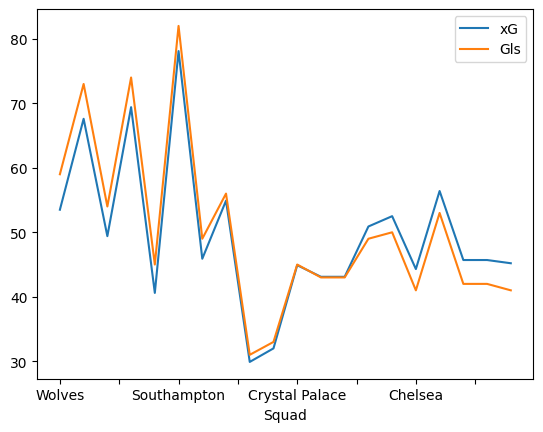

In [525]:
line_chart(df_dat_24)

<Axes: ylabel='Squad'>

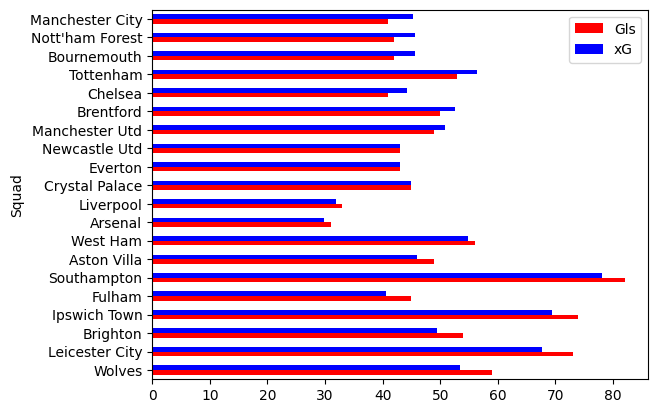

In [526]:
bar_chart_h(df_dat_24)

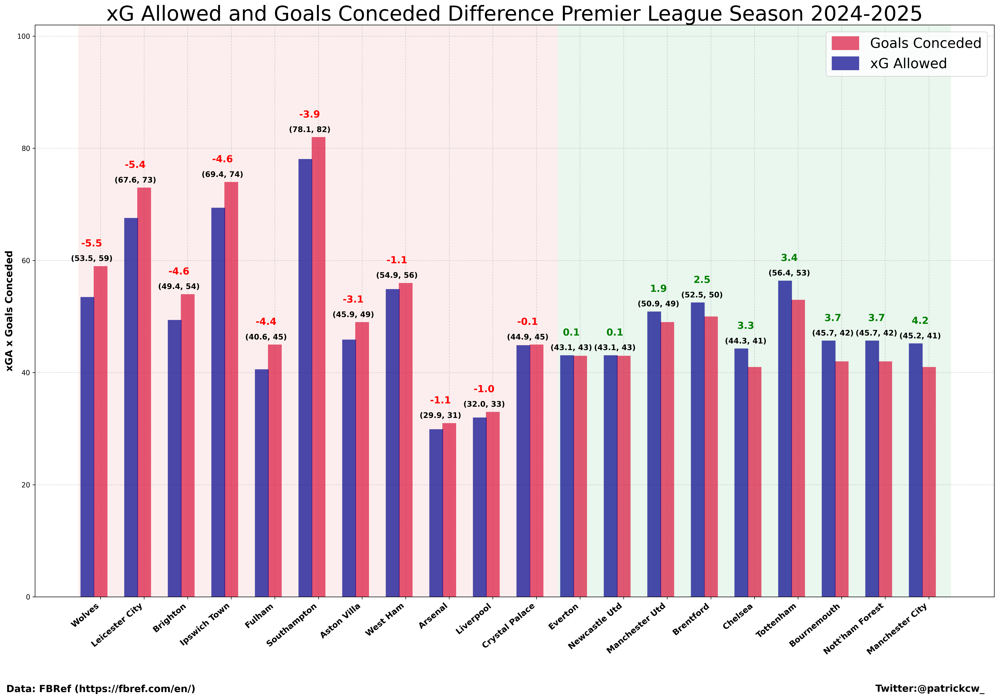

In [527]:
season = "2024-2025"
filename = "xGA_GA_Diff_2024_2025.png"
visualization_xga(df_dat_24, season, filename)

# Used

# All based on Ranking

In [528]:
df_standing_2022 = pd.read_html('https://fbref.com/en/comps/9/2022-2023/2022-2023-Premier-League-Stats')
df_standing_2023 = pd.read_html('https://fbref.com/en/comps/9/2023-2024/2023-2024-Premier-League-Stats')
df_standing_2024 = pd.read_html('https://fbref.com/en/comps/9/Premier-League-Stats')

### Function

In [564]:
def preprocess_all(df):
    df = pd.DataFrame(df[0])
    df = df.sort_values('Rk',ascending=False).reset_index(drop=True) 
    df['G-xG'] = df.GF-df.xG
    df['xGA-GA'] = df.xGA-df.GA
    df['GD-xGD'] = df.GD-df.xGD
    return df

def visualization_xg_with_mark(df, season, filename):
    # Draw plot
    viz_dat=df[['Rk','Squad','GA','GF','GD','xG','xGA','xGD','G-xG','xGA-GA','GD-xGD']]
    viz_dat = viz_dat.sort_values('G-xG',ascending=True).reset_index(drop=True)
    fig, ax = plt.subplots(figsize=(25,15), facecolor='white', dpi= 300)

    x=viz_dat.index
    w = 0.3
    ax.vlines(x=x, ymin=0, ymax=viz_dat.GF, color='seagreen', alpha=0.7, linewidth=20,label="Goals")
    ax.vlines(x=x-w, ymin=0, ymax=viz_dat.xG, color='darkblue', alpha=0.7, linewidth=20,label="xG")
    #ax.bar(x-w,viz_dat.xG,width=w,color='green',align='center')
    #ax.bar(x,viz_dat.Gls,width=w,color='firebrick',align='center')
    ax.legend(loc="upper left",fontsize="20")

    # Annotate Text
    for i, a in enumerate(viz_dat.GF):
        if a>=viz_dat['xG'][i]:
            ax.text(i-0.2, a+3.5, round(viz_dat['G-xG'][i],1), horizontalalignment='center', fontdict={'size':14,'fontweight':'bold','color':'green'})
            ax.text(i-0.2, a+0.9, (viz_dat['xG'][i],viz_dat['GF'][i]), horizontalalignment='center',fontdict={'size':11,'fontweight':'bold'})
        else:
            ax.text(i-0.2, viz_dat['xG'][i]+3.5, round(viz_dat['G-xG'][i],1), horizontalalignment='center',fontdict={'size':14,'fontweight':'bold','color':'red'})
            ax.text(i-0.2, viz_dat['xG'][i]+0.9, (viz_dat['xG'][i],viz_dat['GF'][i]), horizontalalignment='center',fontdict={'size':11,'fontweight':'bold'})

    # Title, Label, Ticks and Ylim
    ax.set_title(f'xG and Actual Goals - Premier League Season {season} \n', fontdict={'size':30})
    ax.text(0.5, 1.015, "Sorted by G - xG",  transform=ax.transAxes, fontsize=20, fontweight='bold', ha='center')
    ax.set(ylim=(0,max(viz_dat['GF'])+20))
    ax.set_ylabel('xG or Goals',fontsize=14,fontweight='bold')
    plt.xticks(viz_dat.index, viz_dat.Squad, rotation=40, horizontalalignment='right', fontsize=12,fontweight='bold')
    ax.text(-.03, -.17, 'Data: FBRef (https://fbref.com/en/)', ha='left', va='bottom', transform=ax.transAxes,fontdict={'size':14,'fontweight':'bold','color':'black'})
    ax.text(.99, -.17, 'Twitter:@patrickcw_', ha='right', va='bottom', transform=ax.transAxes,fontdict={'size':14,'fontweight':'bold','color':'black'})
   
    plt.grid(axis='x', linestyle='--', alpha=0.5)
    plt.grid(axis='y', linestyle='--', alpha=0.5)

    for i in range(len(viz_dat)):
        color = '#fceeee' if viz_dat["G-xG"][i] < 0 else '#e9f7ee'
        ax.axvspan(i - 0.5, i + 0.5, color=color, zorder=0)

    plt.savefig(filename,bbox_inches='tight')
    plt.show()

def visualization_xga_with_mark(df, season, filename):
    viz_dat = df[['Rk','Squad','GF','GA','GD','xG','xGA','xGD','G-xG','xGA-GA','GD-xGD']]
    viz_dat = viz_dat.sort_values('xGA-GA',ascending=True).reset_index(drop=True)
    # Draw plot

    fig, ax = plt.subplots(figsize=(25,15), facecolor='white', dpi= 300)

    x=viz_dat.index
    w = 0.3
    ax.vlines(x=x, ymin=0, ymax=viz_dat.GA, color='crimson', alpha=0.7, linewidth=20,label="Goals Conceded")
    ax.vlines(x=x-w, ymin=0, ymax=viz_dat.xGA, color='darkblue', alpha=0.7, linewidth=20,label="xG Allowed")
    #ax.bar(x-w,viz_dat.xG,width=w,color='green',align='center')
    #ax.bar(x,viz_dat.Gls,width=w,color='firebrick',align='center')
    ax.legend(loc="upper right",fontsize="20")

    # Annotate Text
    for i, a in enumerate(viz_dat.xGA):
        if a>=viz_dat['GA'][i]:
            ax.text(i-0.2, a+3.5, round(viz_dat['xGA-GA'][i],1), horizontalalignment='center', fontdict={'size':14,'fontweight':'bold','color':'green'})
            ax.text(i-0.2, a+0.9, (viz_dat['xGA'][i],viz_dat['GA'][i]), horizontalalignment='center',fontdict={'size':11,'fontweight':'bold'})
        else:
            ax.text(i-0.2, viz_dat['GA'][i]+3.5, round(viz_dat['xGA-GA'][i],1), horizontalalignment='center',fontdict={'size':14,'fontweight':'bold','color':'red'})
            ax.text(i-0.2, viz_dat['GA'][i]+0.9, (viz_dat['xGA'][i],viz_dat['GA'][i]), horizontalalignment='center',fontdict={'size':11,'fontweight':'bold'})

    # Title, Label, Ticks and Ylim
    ax.set_title(f'xG Allowed and Goals Conceded - Premier League Season {season} \n', fontdict={'size':30})
    ax.text(0.5, 1.015, "Sorted by xGA - GA",  transform=ax.transAxes, fontsize=20, fontweight='bold', ha='center')
    #ax.set_title(f'xG Allowed and Goals Conceded Difference Premier League Season {season}', fontdict={'size':30})
    ax.set(ylim=(0,max(viz_dat['GA'])+20))
    ax.set_ylabel('xGA x Goals Conceded',fontsize=14,fontweight='bold')
    plt.xticks(viz_dat.index, viz_dat.Squad, rotation=40, horizontalalignment='right', fontsize=12,fontweight='bold')
    ax.text(-.03, -.17, 'Data: FBRef (https://fbref.com/en/)', ha='left', va='bottom', transform=ax.transAxes,fontdict={'size':14,'fontweight':'bold','color':'black'})
    ax.text(.99, -.17, 'Twitter:@patrickcw_', ha='right', va='bottom', transform=ax.transAxes,fontdict={'size':14,'fontweight':'bold','color':'black'})
    
    plt.grid(axis='x', linestyle='--', alpha=0.5)
    plt.grid(axis='y', linestyle='--', alpha=0.5)

    for i in range(len(viz_dat)):
        color = '#fceeee' if viz_dat["xGA-GA"][i] < 0 else '#e9f7ee'
        ax.axvspan(i - 0.5, i + 0.5, color=color, zorder=0)
    plt.savefig(filename,bbox_inches='tight')
    plt.show()

def visualization_xg(df, season, filename):
    # Draw plot
    viz_dat=df[['Rk','Squad','GA','GF','GD','xG','xGA','xGD','G-xG','xGA-GA','GD-xGD']]

    fig, ax = plt.subplots(figsize=(25,15), facecolor='white', dpi= 300)

    x=viz_dat.index
    w = 0.3
    ax.vlines(x=x, ymin=0, ymax=viz_dat.GF, color='seagreen', alpha=0.7, linewidth=20,label="Goals")
    ax.vlines(x=x-w, ymin=0, ymax=viz_dat.xG, color='darkblue', alpha=0.7, linewidth=20,label="xG")
    #ax.bar(x-w,viz_dat.xG,width=w,color='green',align='center')
    #ax.bar(x,viz_dat.Gls,width=w,color='firebrick',align='center')
    ax.legend(loc="upper left",fontsize="20")

    # Annotate Text
    for i, a in enumerate(viz_dat.GF):
        if a>=viz_dat['xG'][i]:
            ax.text(i-0.2, a+3.5, round(viz_dat['G-xG'][i],1), horizontalalignment='center', fontdict={'size':14,'fontweight':'bold','color':'green'})
            ax.text(i-0.2, a+0.9, (viz_dat['xG'][i],viz_dat['GF'][i]), horizontalalignment='center',fontdict={'size':11,'fontweight':'bold'})
        else:
            ax.text(i-0.2, viz_dat['xG'][i]+3.5, round(viz_dat['G-xG'][i],1), horizontalalignment='center',fontdict={'size':14,'fontweight':'bold','color':'red'})
            ax.text(i-0.2, viz_dat['xG'][i]+0.9, (viz_dat['xG'][i],viz_dat['GF'][i]), horizontalalignment='center',fontdict={'size':11,'fontweight':'bold'})

    # Title, Label, Ticks and Ylim
    ax.set_title(f'xG and Actual Goals - Premier League Season {season} \n', fontdict={'size':30})
    ax.text(0.5, 1.015, "Sorted by Ranking",  transform=ax.transAxes, fontsize=20, fontweight='bold', ha='center')
    ax.set(ylim=(0,max(viz_dat['GF'])+20))
    ax.set_ylabel('xG or Goals',fontsize=14,fontweight='bold')
    plt.xticks(viz_dat.index, viz_dat.Squad, rotation=40, horizontalalignment='right', fontsize=12,fontweight='bold')
    ax.text(-.03, -.17, 'Data: FBRef (https://fbref.com/en/)', ha='left', va='bottom', transform=ax.transAxes,fontdict={'size':14,'fontweight':'bold','color':'black'})
    ax.text(.99, -.17, 'Twitter:@patrickcw_', ha='right', va='bottom', transform=ax.transAxes,fontdict={'size':14,'fontweight':'bold','color':'black'})
   
    plt.grid(axis='x', linestyle='--', alpha=0.5)
    plt.grid(axis='y', linestyle='--', alpha=0.5)
    plt.savefig(filename,bbox_inches='tight')
    plt.show()

def visualization_xga(df, season, filename):
    viz_dat = df[['Rk','Squad','GF','GA','GD','xG','xGA','xGD','G-xG','xGA-GA','GD-xGD']]
    # Draw plot

    fig, ax = plt.subplots(figsize=(25,15), facecolor='white', dpi= 300)

    x=viz_dat.index
    w = 0.3
    ax.vlines(x=x, ymin=0, ymax=viz_dat.GA, color='crimson', alpha=0.7, linewidth=20,label="Goals Conceded")
    ax.vlines(x=x-w, ymin=0, ymax=viz_dat.xGA, color='darkblue', alpha=0.7, linewidth=20,label="xG Allowed")
    #ax.bar(x-w,viz_dat.xG,width=w,color='green',align='center')
    #ax.bar(x,viz_dat.Gls,width=w,color='firebrick',align='center')
    ax.legend(loc="upper right",fontsize="20")

    # Annotate Text
    for i, a in enumerate(viz_dat.xGA):
        if a>=viz_dat['GA'][i]:
            ax.text(i-0.2, a+3.5, round(viz_dat['xGA-GA'][i],1), horizontalalignment='center', fontdict={'size':14,'fontweight':'bold','color':'green'})
            ax.text(i-0.2, a+0.9, (viz_dat['xGA'][i],viz_dat['GA'][i]), horizontalalignment='center',fontdict={'size':11,'fontweight':'bold'})
        else:
            ax.text(i-0.2, viz_dat['GA'][i]+3.5, round(viz_dat['xGA-GA'][i],1), horizontalalignment='center',fontdict={'size':14,'fontweight':'bold','color':'red'})
            ax.text(i-0.2, viz_dat['GA'][i]+0.9, (viz_dat['xGA'][i],viz_dat['GA'][i]), horizontalalignment='center',fontdict={'size':11,'fontweight':'bold'})

    # Title, Label, Ticks and Ylim
    ax.set_title(f'xG Allowed and Goals Conceded - Premier League Season {season} \n', fontdict={'size':30})
    ax.text(0.5, 1.015, "Sorted by Ranking",  transform=ax.transAxes, fontsize=20, fontweight='bold', ha='center')
    #ax.set_title(f'xG Allowed and Goals Conceded Difference Premier League Season {season}', fontdict={'size':30})
    ax.set(ylim=(0,max(viz_dat['GA'])+20))
    ax.set_ylabel('xGA x Goals Conceded',fontsize=14,fontweight='bold')
    plt.xticks(viz_dat.index, viz_dat.Squad, rotation=40, horizontalalignment='right', fontsize=12,fontweight='bold')
    ax.text(-.03, -.17, 'Data: FBRef (https://fbref.com/en/)', ha='left', va='bottom', transform=ax.transAxes,fontdict={'size':14,'fontweight':'bold','color':'black'})
    ax.text(.99, -.17, 'Twitter:@patrickcw_', ha='right', va='bottom', transform=ax.transAxes,fontdict={'size':14,'fontweight':'bold','color':'black'})
    
    plt.grid(axis='x', linestyle='--', alpha=0.5)
    plt.grid(axis='y', linestyle='--', alpha=0.5)
    plt.savefig(filename,bbox_inches='tight')
    plt.show()

def visualization_xgd(df, season, filename):
    df = df.sort_values('Rk',ascending=True).reset_index(drop=True)
    viz_dat=df[['Rk','Squad','GA','GF','GD','xG','xGA','xGD','G-xG','xGA-GA','GD-xGD']]

    fig, ax = plt.subplots(figsize=(25, 20), facecolor='white', dpi=300)

    bar_width = 0.35
    y = np.arange(len(viz_dat))

    # Bars
    ax.barh(y + bar_width/2, viz_dat['GD'], height=bar_width, color='#B0B8C5', alpha=0.7, label='GD')
    ax.barh(y - bar_width/2, viz_dat['xGD'], height=bar_width, color='darkblue', alpha=0.7, label='xGD')

    # Annotations
    for i in range(len(viz_dat)):
        gd = viz_dat['GD'].iloc[i]
        xgd = viz_dat['xGD'].iloc[i]
        diff = viz_dat['GD-xGD'].iloc[i]
        color = 'green' if diff > 0 else 'red'

        # Annotate difference
        ax.text(max(gd, xgd) + 3 if max(gd, xgd) >= 0 else 3.5,
                i-0.15, f'{diff:+.1f}',
                va='center', ha='center',
                fontdict={'size':14, 'fontweight':'bold', 'color':color})

        # Annotate (xGD, GD) pair
        ax.text(max(gd, xgd) + 3 if gd >= 0 else 3.5,
                i+0.15, f'({xgd:.1f}, {gd})',
                va='center', ha='center',
                fontdict={'size':12, 'fontweight':'bold'})

    # Title, labels, and other formatting
    ax.set_yticks(y)
    ax.set_yticklabels(viz_dat['Squad'], fontsize=12, fontweight='bold')
    ax.invert_yaxis()
    ax.set_xlabel('Goal Difference (GD) and Expected Goal Difference (xGD)', fontsize=14, fontweight='bold')
    ax.set_title(f'Goals Difference (GD) vs Expected Goals Difference (xGD) - Premier League Season {season} \n', fontsize=30)
    ax.text(0.5, 1.01, 'Sorted by Ranking', transform=ax.transAxes, ha='center', fontsize=20, fontweight='bold')
    ax.legend(loc='upper left', fontsize=20)

    # Watermarks / footnotes
    ax.text(-.03, -0.08, 'Data: FBRef (https://fbref.com/en/)', ha='left', va='bottom',
            transform=ax.transAxes, fontdict={'size':14, 'fontweight':'bold'})
    ax.text(1.02, -0.08, 'Twitter: @patrickcw_', ha='right', va='bottom',
            transform=ax.transAxes, fontdict={'size':14, 'fontweight':'bold'})

    # Grid
    plt.grid(axis='x', linestyle='--', alpha=0.5)
    plt.grid(axis='y', linestyle='--', alpha=0.5)
    plt.savefig(filename,bbox_inches='tight')
    plt.show()

## Preprocess

In [545]:
df_all_22 = preprocess_all(df_standing_2022)
df_all_23 = preprocess_all(df_standing_2023)
df_all_24 = preprocess_all(df_standing_2024)

### Prem 2022

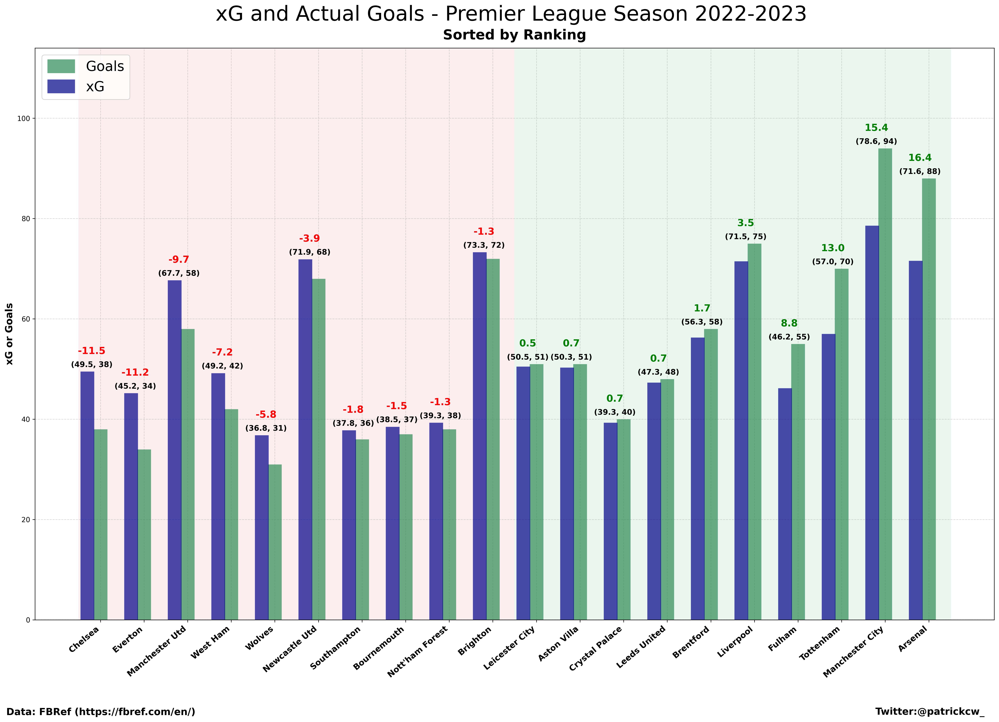

In [562]:
season = "2022-2023"
filename = "xG_G_Diff_2022_2023.png"
visualization_xg_with_mark(df_all_22, season, filename)

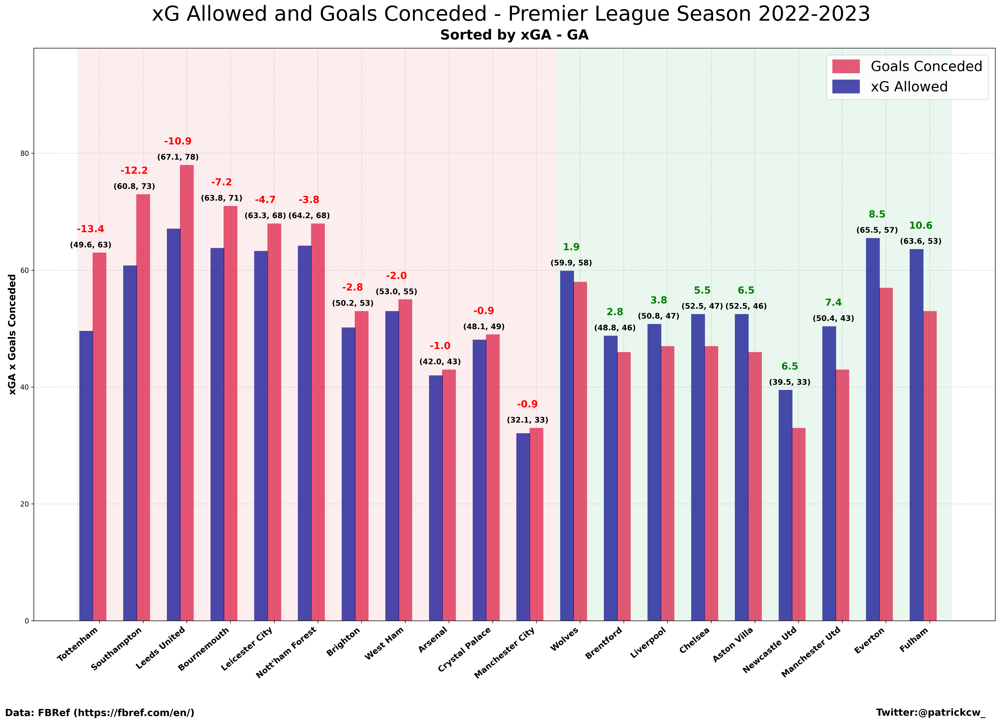

In [565]:
season = "2022-2023"
filename = "xGA_GA_Diff_2022_2023.png"
visualization_xga_with_mark(df_all_22, season, filename)

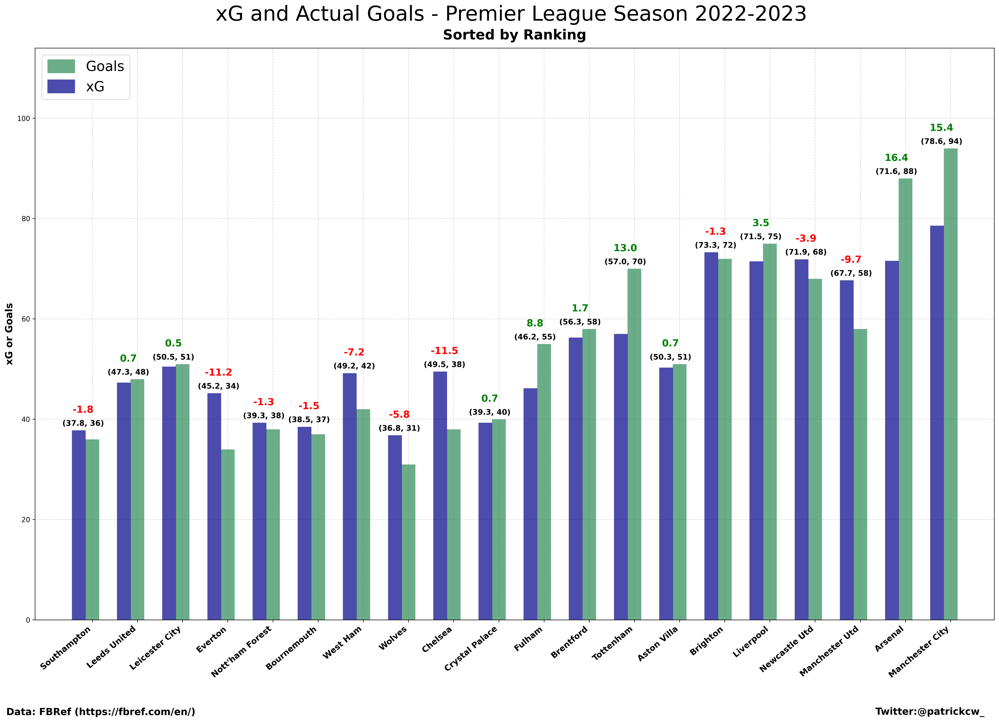

In [543]:
season = "2022-2023"
filename = "xG_G_Diff_2022_2023_sorted.png"
visualization_xg(df_all_22, season, filename)

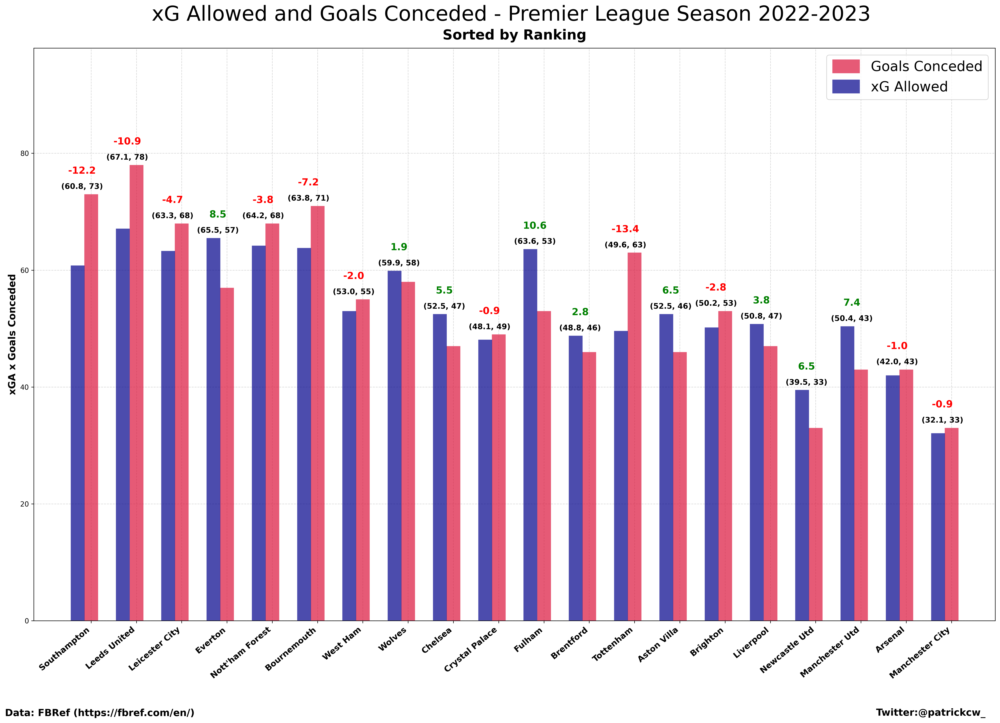

In [532]:
season = "2022-2023"
filename = "xGA_GA_Diff_2022_2023_sorted.png"
visualization_xga(df_all_22, season, filename)

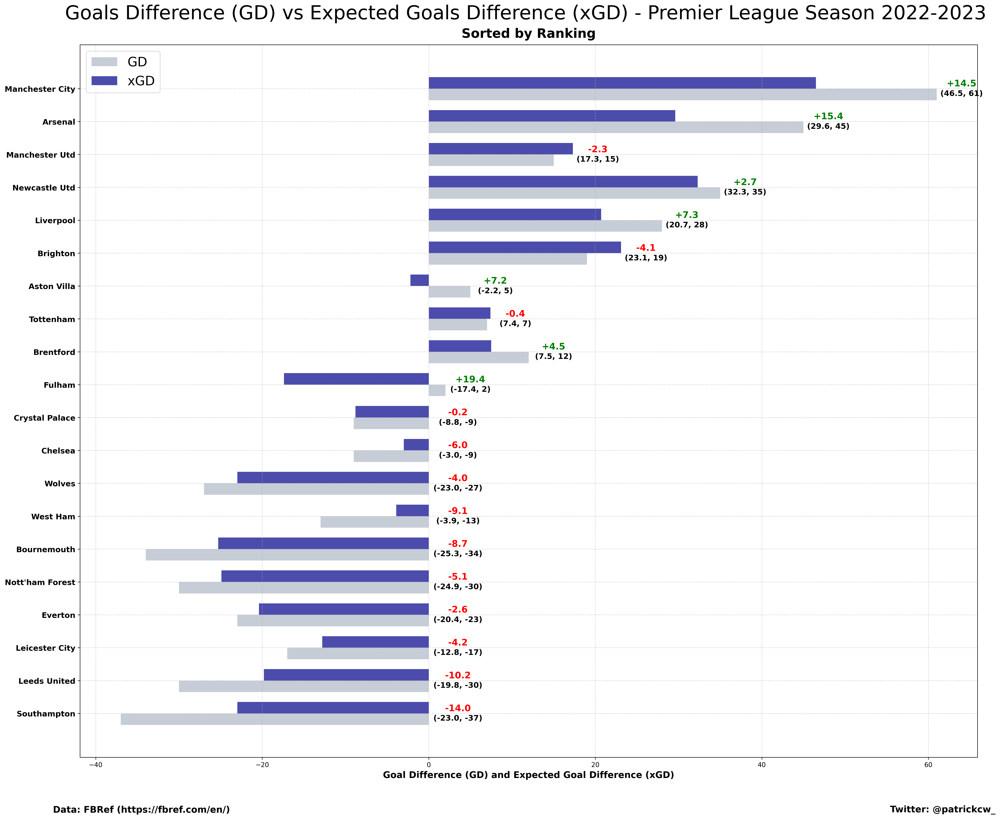

In [533]:
season = "2022-2023"
filename = "xGD_GD_Diff_2022_2023_sorted.png"
visualization_xgd(df_all_22, season, filename)

### Prem 2023

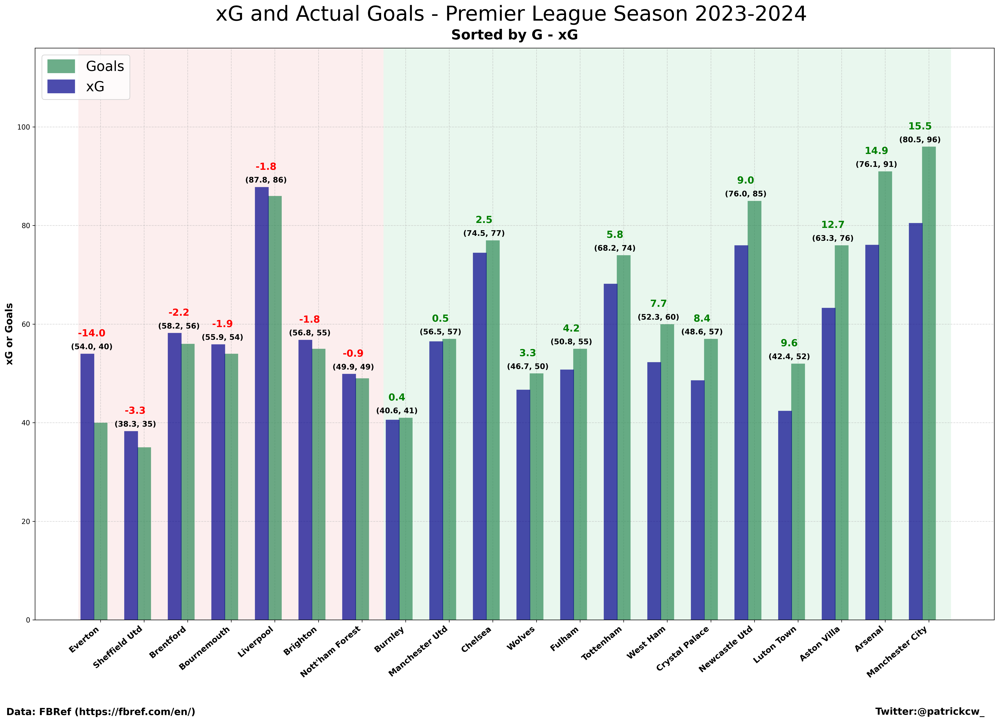

In [566]:
season = "2023-2024"
filename = "xG_G_Diff_2023_2024.png"
visualization_xg_with_mark(df_all_23, season, filename)

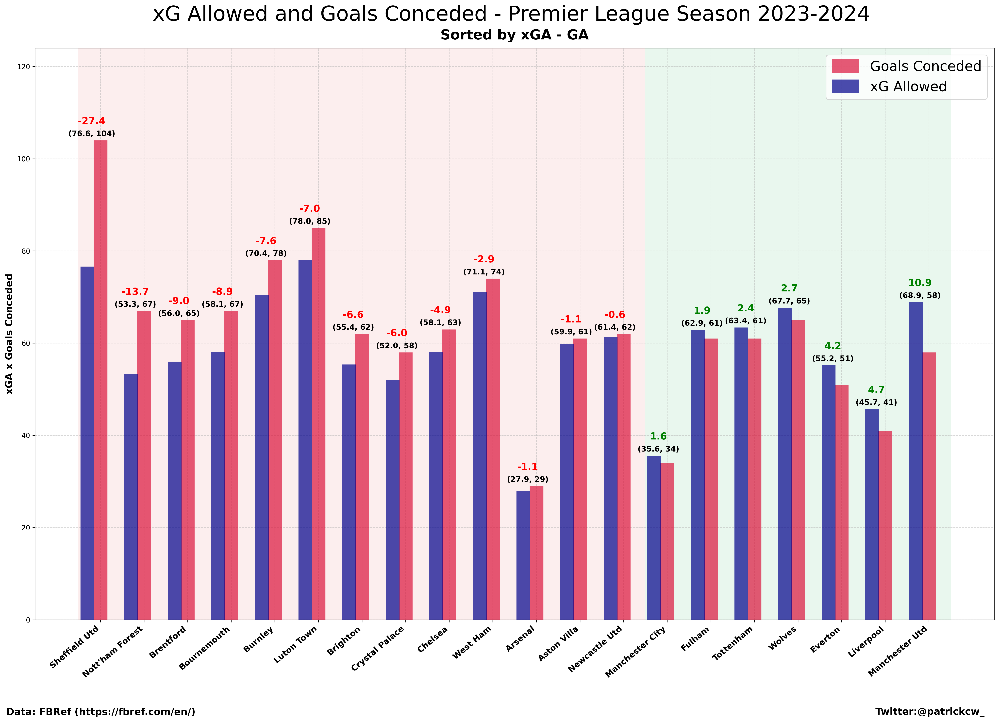

In [567]:
season = "2023-2024"
filename = "xGA_GA_Diff_2023_2024.png"
visualization_xga_with_mark(df_all_23, season, filename)

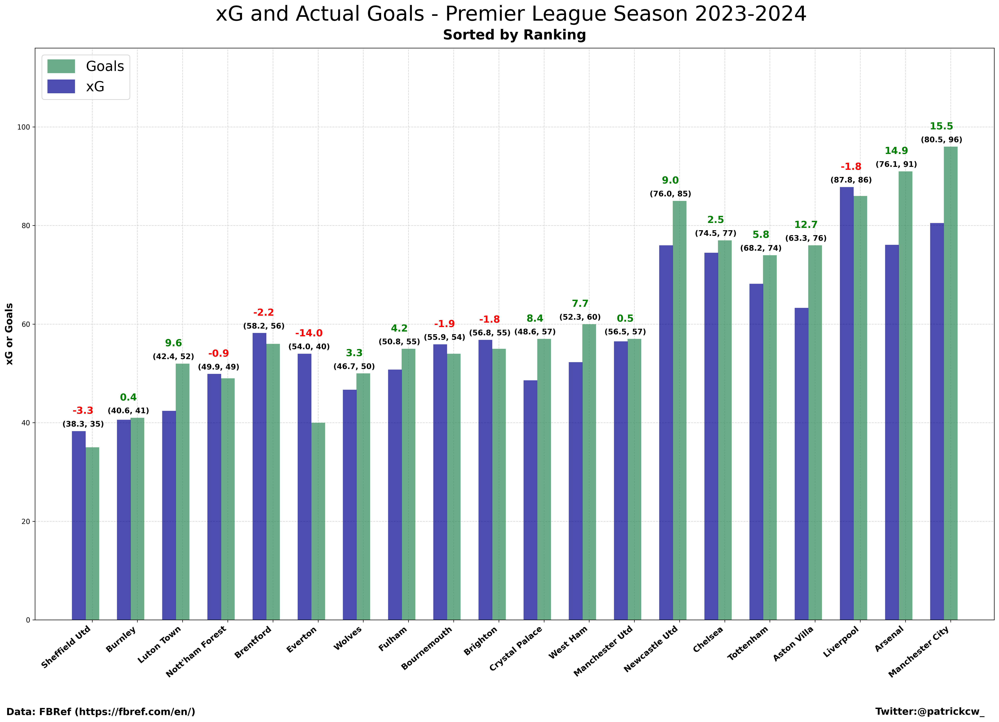

In [534]:
season = "2023-2024"
filename = "xG_G_Diff_2023_2024_sorted.png"
visualization_xg(df_all_23, season, filename)

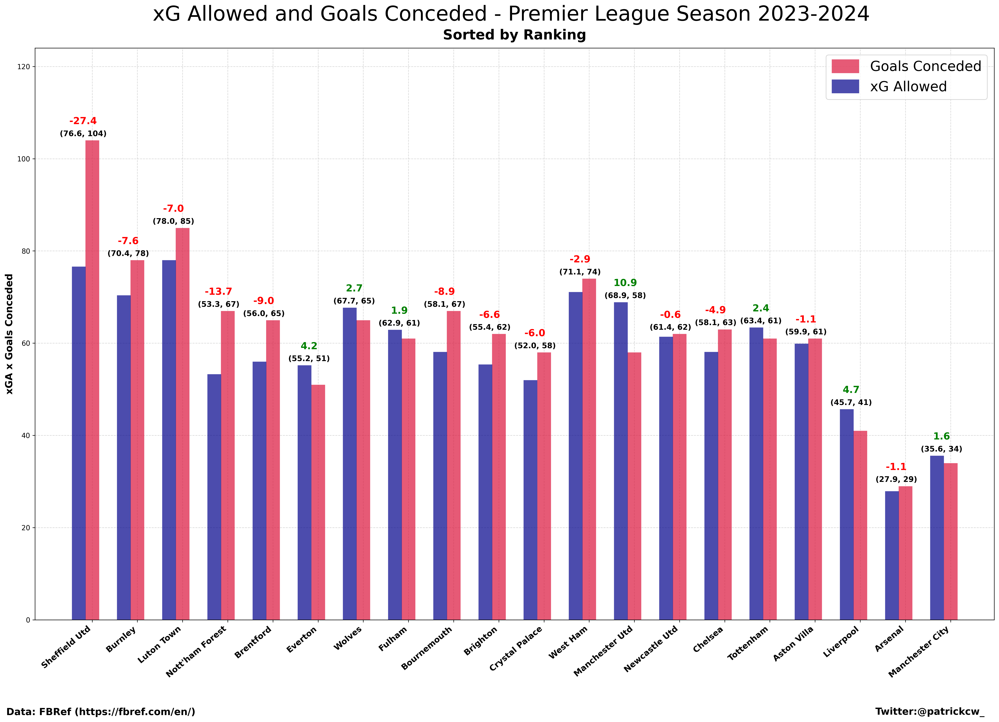

In [535]:
season = "2023-2024"
filename = "xGA_GA_Diff_2023_2024_sorted.png"
visualization_xga(df_all_23, season, filename)

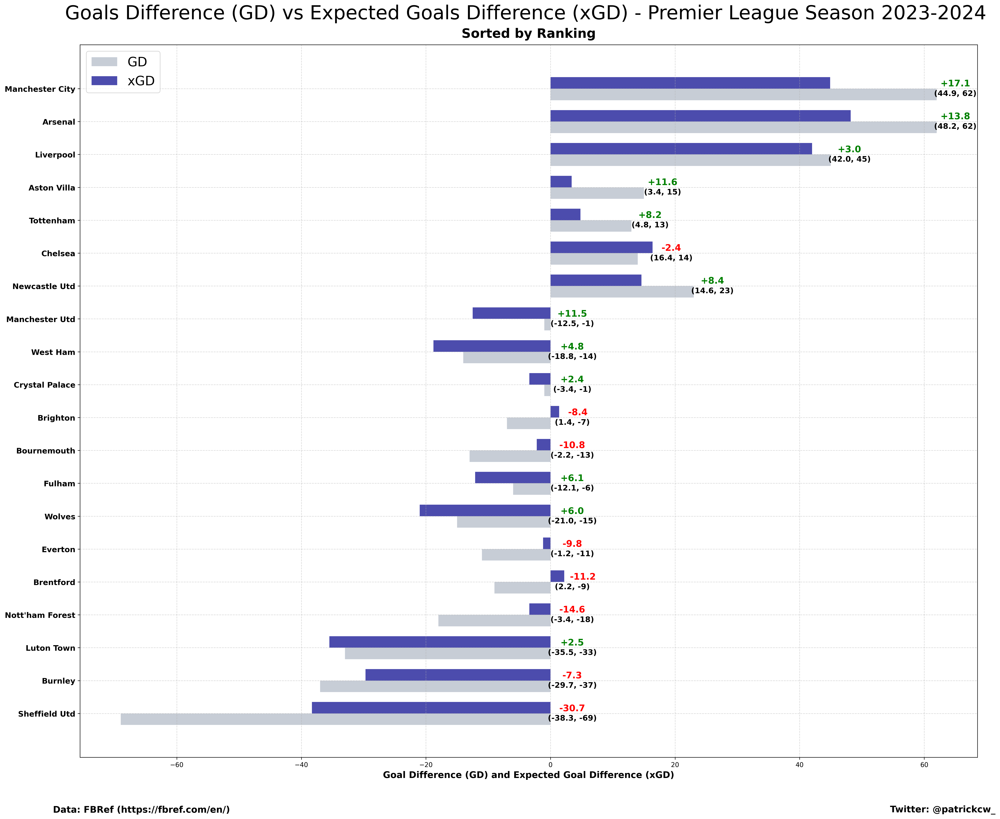

In [536]:
season = "2023-2024"
filename = "xGD_GD_Diff_2023_2024_sorted.png"
visualization_xgd(df_all_23, season, filename)

### Prem 2024

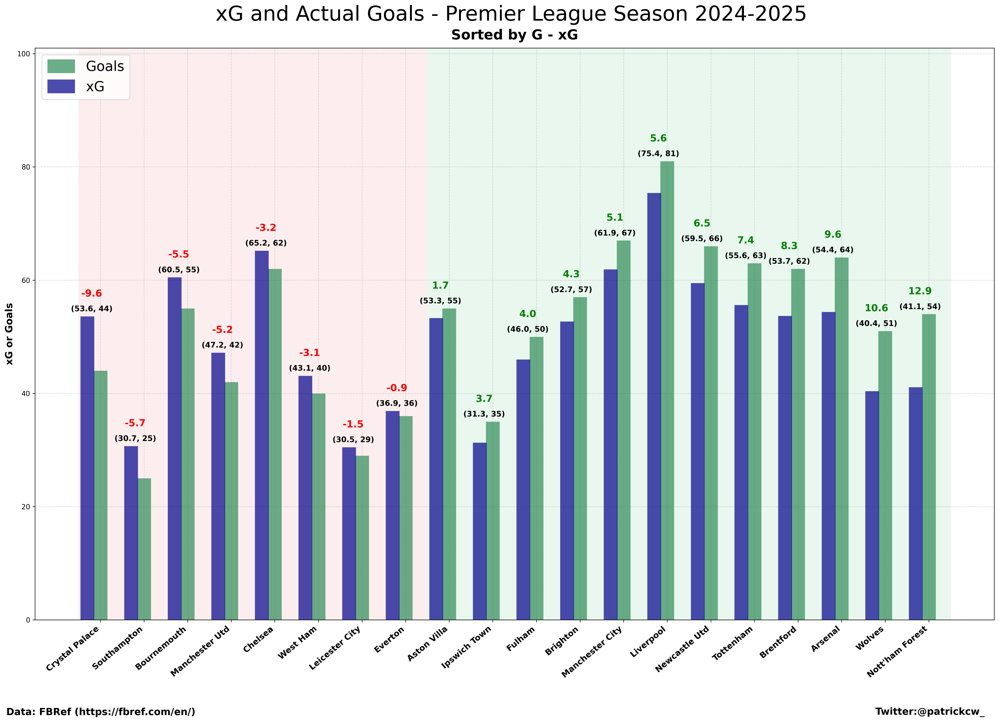

In [569]:
season = "2024-2025"
filename = "xG_G_Diff_2024_2025.png"
visualization_xg_with_mark(df_all_24, season, filename)

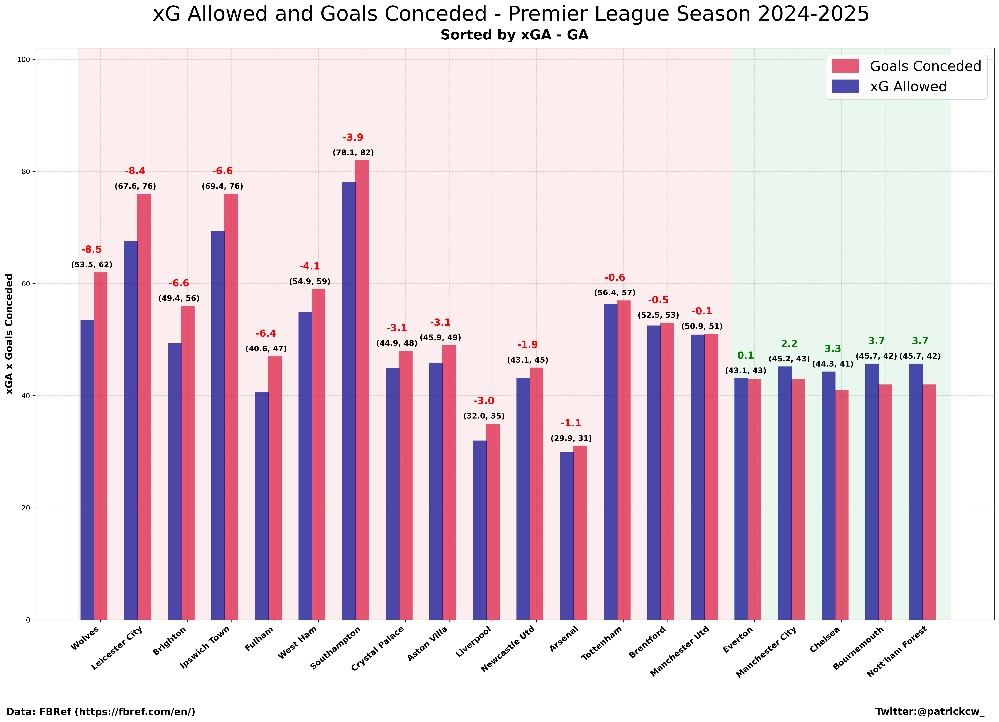

In [570]:
season = "2024-2025"
filename = "xGA_GA_Diff_2024_2025.png"
visualization_xga_with_mark(df_all_24, season, filename)

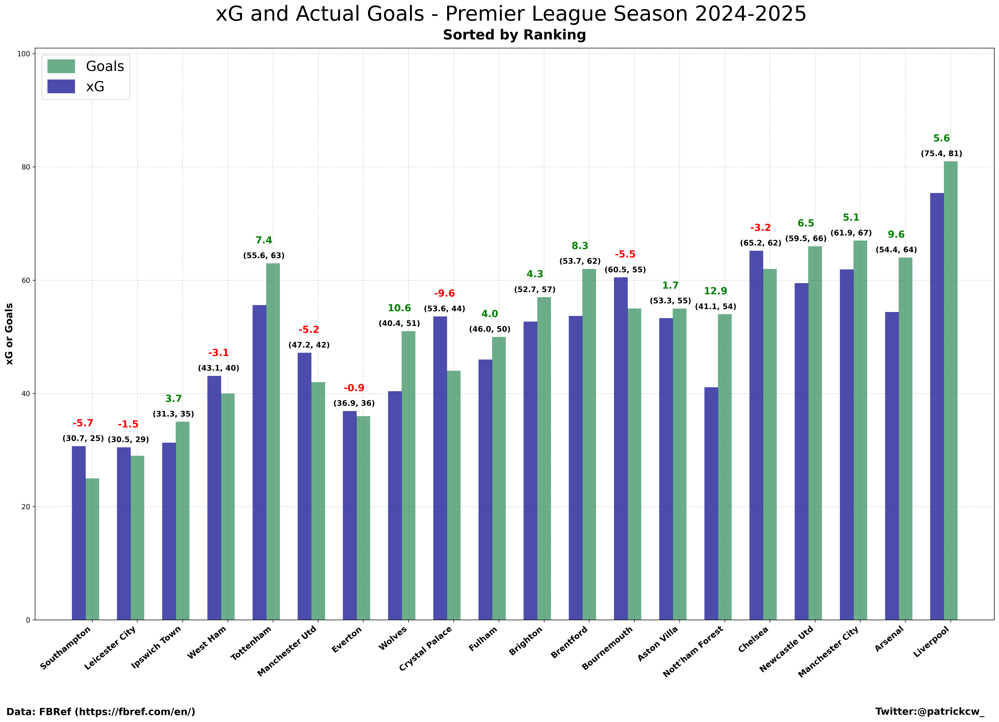

In [537]:
season = "2024-2025"
filename = "xG_G_Diff_2024_2025_sorted.png"
visualization_xg(df_all_24, season, filename)

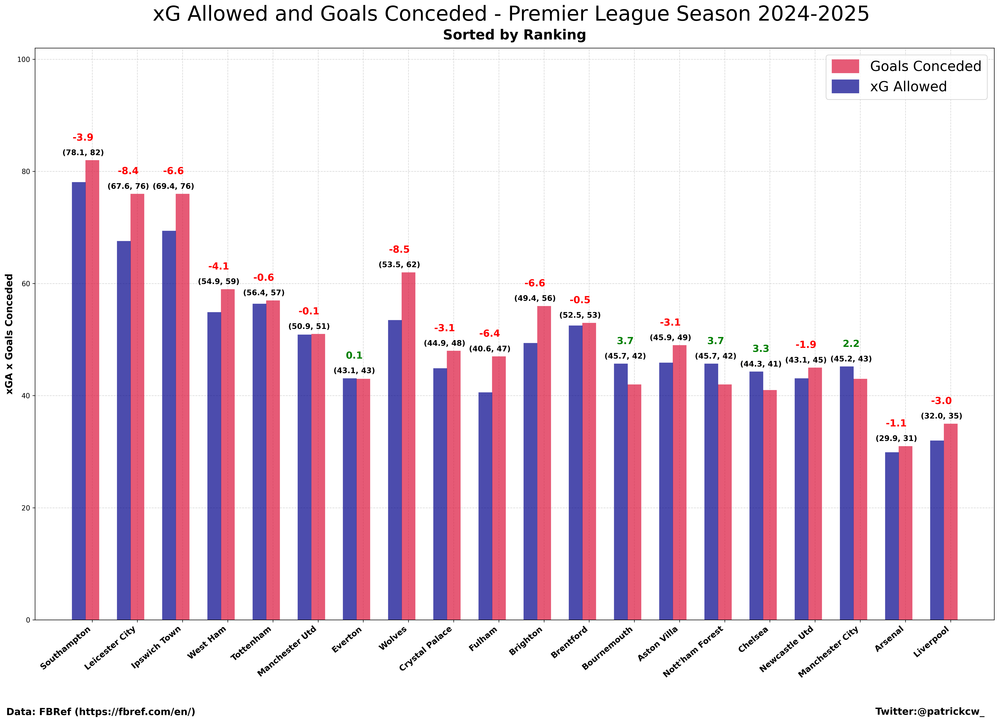

In [540]:
season = "2024-2025"
filename = "xGA_GA_Diff_2024_2025_sorted.png"
visualization_xga(df_all_24, season, filename)

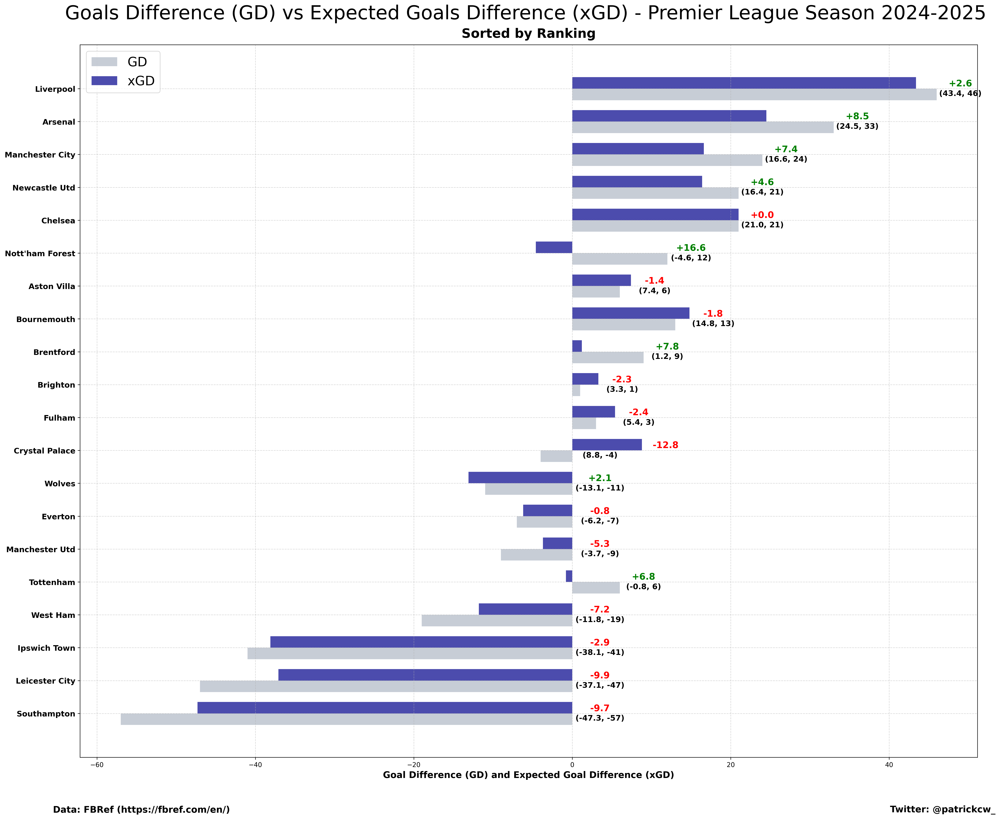

In [541]:
season = "2024-2025"
filename = "xGD_GD_Diff_2024_2025_sorted.png"
visualization_xgd(df_all_24, season, filename)